In [1]:
%matplotlib inline

In [14]:
import scanpy as sc
import squidpy as sq

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

sc.logging.print_header()
print(f"squidpy=={sq.__version__}")

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.5 scipy==1.7.3 pandas==1.4.2 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.11 pynndescent==0.5.7
squidpy==1.2.2


A Visium slide of a coronal section of the mouse brain
---

already has annotations
pre-processed

In [30]:
adata = sq.datasets.visium_hne_adata()
adata

AnnData object with n_obs × n_vars = 2688 × 18078
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden', 'cluster'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'cluster_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

![title](practicum/picanndata.png)

In [4]:
print(adata.X)

  (0, 2)	0.87893134
  (0, 3)	0.87893134
  (0, 4)	1.3393729
  (0, 6)	1.8921022
  (0, 9)	0.87893134
  (0, 12)	1.6534499
  (0, 15)	0.87893134
  (0, 16)	1.3393729
  (0, 23)	0.87893134
  (0, 29)	0.87893134
  (0, 30)	1.3393729
  (0, 31)	1.3393729
  (0, 34)	0.87893134
  (0, 46)	2.2460093
  (0, 48)	1.3393729
  (0, 50)	1.8921022
  (0, 51)	1.3393729
  (0, 54)	0.87893134
  (0, 65)	1.3393729
  (0, 71)	0.87893134
  (0, 72)	0.87893134
  (0, 74)	1.3393729
  (0, 75)	0.87893134
  (0, 78)	1.6534499
  (0, 81)	1.3393729
  :	:
  (2687, 18008)	1.1892449
  (2687, 18012)	0.76188
  (2687, 18013)	0.76188
  (2687, 18014)	0.76188
  (2687, 18026)	0.76188
  (2687, 18028)	1.1892449
  (2687, 18030)	0.76188
  (2687, 18040)	0.76188
  (2687, 18051)	1.1892449
  (2687, 18053)	0.76188
  (2687, 18054)	1.7172513
  (2687, 18058)	5.8162
  (2687, 18059)	5.4937506
  (2687, 18060)	6.528097
  (2687, 18061)	6.485456
  (2687, 18062)	2.423093
  (2687, 18063)	6.728654
  (2687, 18064)	6.698133
  (2687, 18065)	5.175665
  (2687, 18066)	2

In [5]:
print(adata.X[1,3])

1.0922161


In [6]:
display(adata.obs)

,in_tissue,array_row,array_col,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_counts,leiden,cluster
AAACAAGTATCTCCCA-1,1,50,102,4928,8.502891,19340.0,9.869983,38.428128,43.133402,49.214064,60.449845,3857.0,8.257904,19.943123,19340.0,2,Cortex_2
AAACAATCTACTAGCA-1,1,3,43,3448,8.145840,13750.0,9.528867,50.516364,55.141818,60.952727,70.574545,3267.0,8.091933,23.760000,13750.0,11,Cortex_5
AAACACCAATAACTGC-1,1,59,19,6022,8.703341,32710.0,10.395467,40.483033,47.071232,54.564353,65.087129,4910.0,8.499233,15.010699,32710.0,7,Thalamus_2
AAACAGAGCGACTCCT-1,1,14,94,4311,8.369157,15909.0,9.674704,40.957948,45.810547,52.077440,62.976931,3270.0,8.092851,20.554403,15909.0,11,Cortex_5
AAACCGGGTAGGTACC-1,1,42,28,5787,8.663542,31856.0,10.369013,40.287544,45.887745,52.982170,64.248493,6693.0,8.808967,21.010170,31856.0,7,Thalamus_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1,1,31,77,7016,8.856091,34390.0,10.445550,30.994475,37.758069,45.891247,57.321896,4002.0,8.294800,11.637104,34390.0,12,Lateral_ventricle
TTGTTTCACATCCAGG-1,1,58,42,6995,8.853094,44372.0,10.700386,33.284504,40.203281,48.906968,61.421617,5739.0,8.655214,12.933832,44372.0,6,Hypothalamus_1
TTGTTTCATTAGTCTA-1,1,60,30,5082,8.533657,24432.0,10.103690,38.506876,45.640963,53.675508,65.307793,3560.0,8.177796,14.571054,24432.0,6,Hypothalamus_1
TTGTTTCCATACAACT-1,1,45,27,5661,8.641532,27381.0,10.217641,36.886892,42.441839,49.589131,60.998503,5296.0,8.574896,19.341881,27381.0,7,Thalamus_2


In [7]:
display(adata.var)

,gene_ids,feature_types,genome,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells,highly_variable,highly_variable_rank,means,variances,variances_norm
Xkr4,ENSMUSG00000051951,Gene Expression,mm10,False,233,0.093032,0.088955,91.363973,251.0,5.529429,233,False,NaN,0.093378,0.098832,0.815019
Sox17,ENSMUSG00000025902,Gene Expression,mm10,False,298,0.128243,0.120662,88.954781,346.0,5.849325,298,False,NaN,0.128720,0.156108,0.931378
Mrpl15,ENSMUSG00000033845,Gene Expression,mm10,False,1775,1.370645,0.863162,34.210526,3698.0,8.215817,1775,False,NaN,1.375744,2.163193,0.850736
Lypla1,ENSMUSG00000025903,Gene Expression,mm10,False,1294,0.741290,0.554626,52.038547,2000.0,7.601402,1293,False,NaN,0.743676,0.984143,0.873699
Tcea1,ENSMUSG00000033813,Gene Expression,mm10,False,1975,1.727947,1.003549,26.797628,4662.0,8.447414,1974,False,NaN,1.734003,3.030447,0.856292
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Tmlhe,ENSMUSG00000079834,Gene Expression,mm10,False,72,0.027798,0.027419,97.331357,75.0,4.330733,72,False,NaN,0.027902,0.029366,0.888284
Gm10931,ENSMUSG00000094350,Gene Expression,mm10,False,5,0.001853,0.001852,99.814678,5.0,1.791759,5,False,NaN,0.001860,0.001857,0.984078
AC149090.1,ENSMUSG00000095041,Gene Expression,mm10,False,2319,3.296887,1.457891,14.047443,8895.0,9.093357,2318,True,3150.0,3.308780,10.516454,1.096961
CAAA01118383.1,ENSMUSG00000063897,Gene Expression,mm10,False,695,0.320237,0.277811,74.240178,864.0,6.762730,694,False,NaN,0.321057,0.370647,0.850570


<AxesSubplot:xlabel='n_genes_by_counts'>

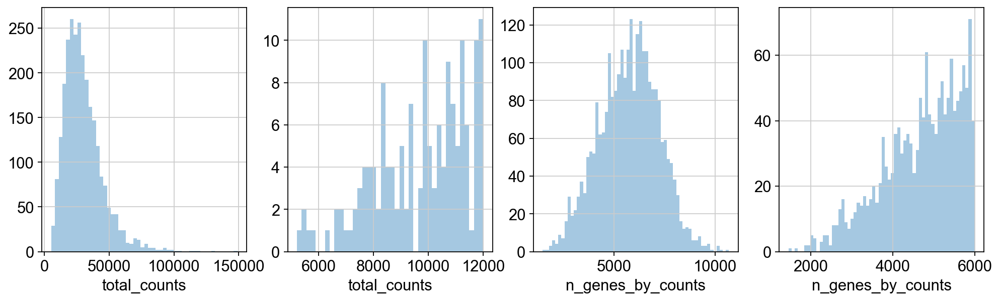

In [21]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.distplot(adata.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(adata.obs["total_counts"][adata.obs["total_counts"] < 12000], kde=False, bins=40, ax=axs[1])
sns.distplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.distplot(adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 6000], kde=False, bins=60, ax=axs[3])

In [25]:
#sc.pp.filter_cells(adata, min_counts=10000)
#sc.pp.filter_cells(adata, max_counts=50000)
#sc.pp.filter_genes(adata, min_cells=10)

filtered out 51 cells that have less than 10000 counts  
filtered out 26 cells that have more than 50000 counts

Visualize cluster annotation in spatial context
-----------

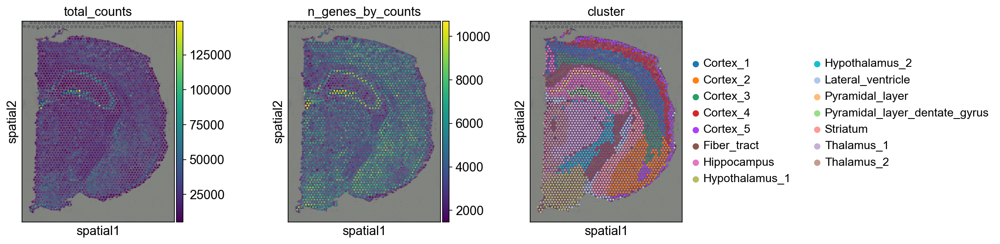

In [32]:
sc.set_figure_params(facecolor="white", figsize=(4,4))
sc.pl.spatial(adata, color=["total_counts", "n_genes_by_counts","cluster"])

overlay the circular spots on top of the Hematoxylin and eosin stain (H&E) image provided

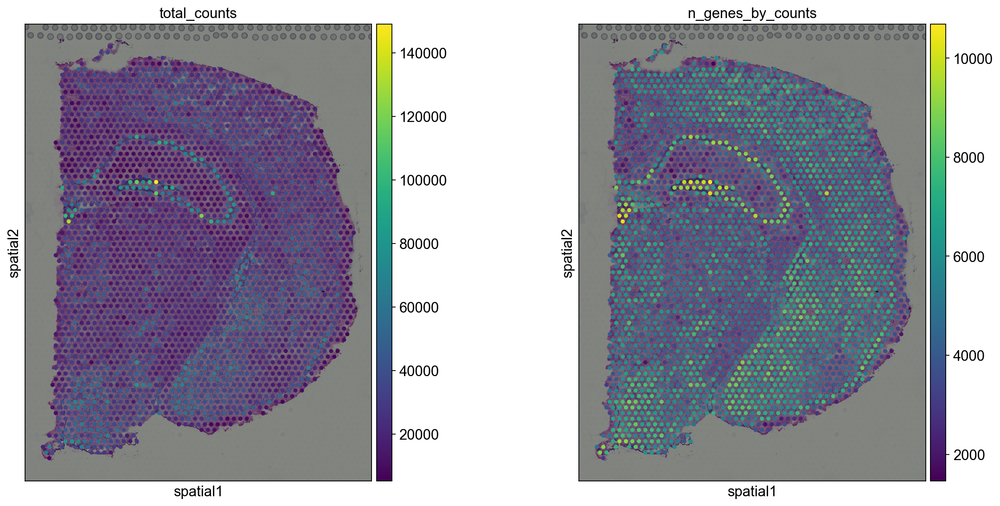

In [33]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", color=["total_counts", "n_genes_by_counts"])

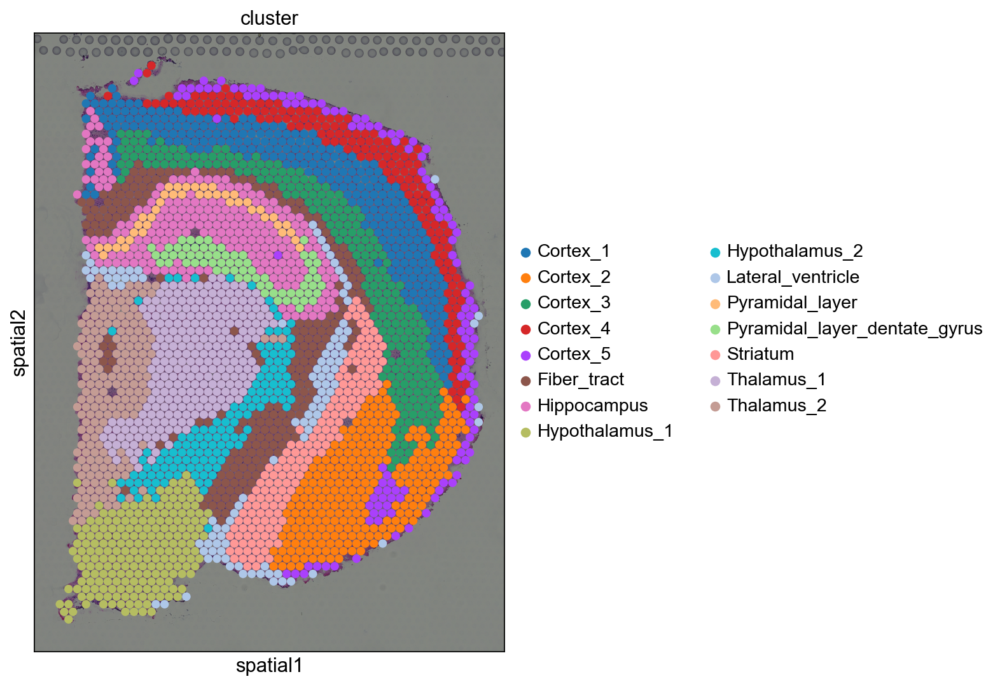

In [37]:
sc.pl.spatial(adata, color="cluster", size=1.5)

/Users/yida/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


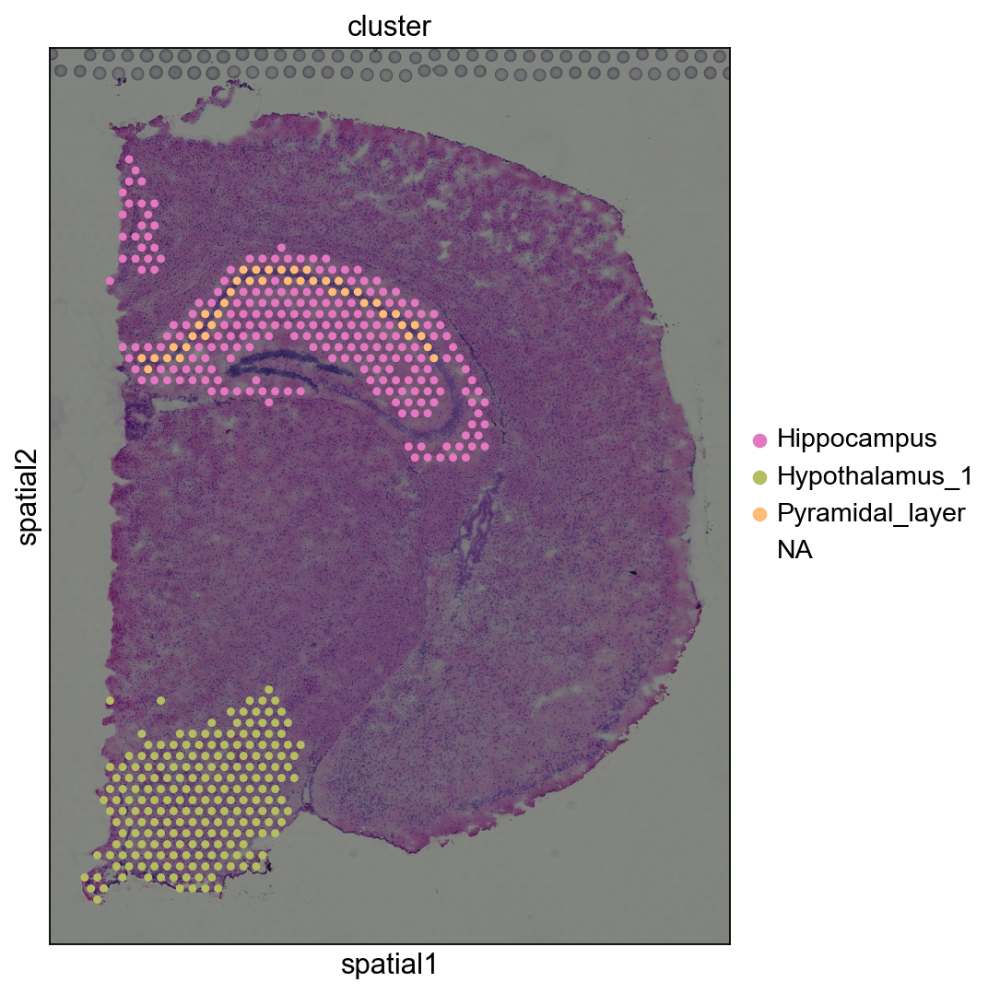

In [46]:
sc.pl.spatial(adata, color="cluster", groups=["Pyramidal_layer", "Hippocampus", "Hypothalamus_1"])

Neighborhood enrichment
-----

In [42]:
sq.gr.spatial_neighbors(adata)

In [43]:
sq.gr.nhood_enrichment(adata, cluster_key='cluster')

  0%|          | 0/1000 [00:00<?, ?/s]

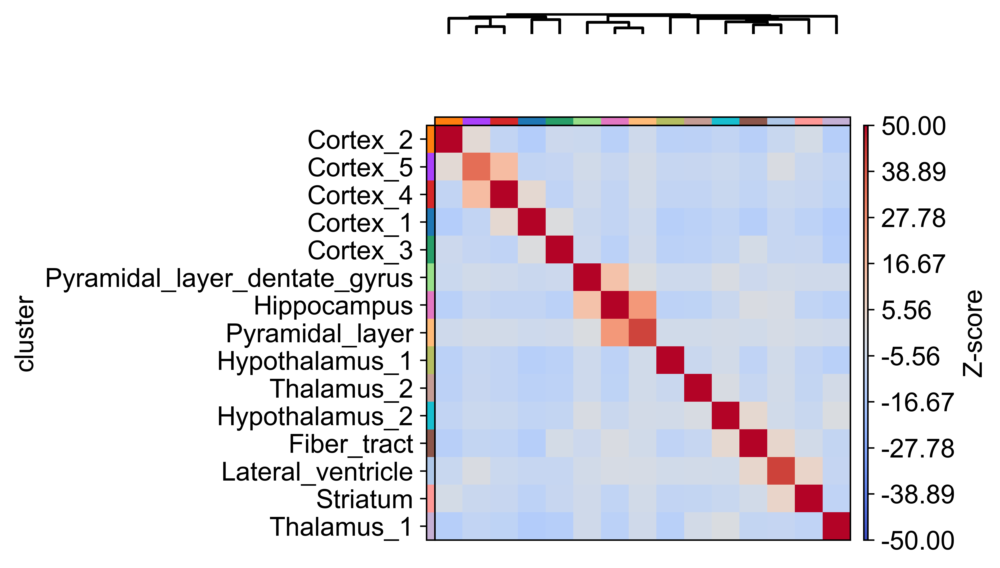

In [44]:
sq.pl.nhood_enrichment(
    adata,
    cluster_key="cluster",
    cmap="coolwarm",
    title="",
    method="ward",
    dpi=300,
    figsize=(5, 4),
    cbar_kwargs={"label": "Z-score"},
    vmin=-50,
    vmax=50,
)



Pyramidal_layer_dentate_gyrus and Pyramidal_layer clusters seems to be often neighbors with the larger Hippocampus cluster.
Given the spatial organization of the mouse brain coronal section, not surprisingly we find high neighborhood enrichment the Hippocampus region: Pyramidal_layer_dentate_gyrus and Pyramidal_layer clusters seems to be often neighbors with the larger Hippocampus cluster.

Co-occurrence across spatial dimensions
=======================================

In addition to the neighbor enrichment score, we can visualize cluster
co-occurrence in spatial dimensions. This is a similar analysis of the
one presented above, yet it does not operate on the connectivity matrix,
but on the original spatial coordinates. The co-occurrence score is
defined as:

$$\frac{p(exp|cond)}{p(exp)}$$

where $p(exp|cond)$ is the conditional probability of observing a
cluster $exp$ conditioned on the presence of a cluster $cond$, whereas
$p(exp)$ is the probability of observing $exp$ in the radius size of
interest. The score is computed across increasing radii size around each
cell in the tissue.

  0%|          | 0/1 [00:00<?, ?/s]

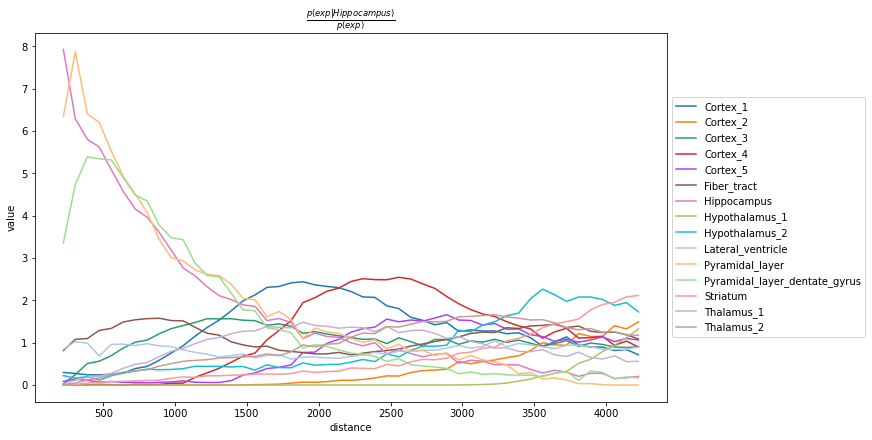

In [66]:
sq.gr.co_occurrence(adata, cluster_key="cluster")
sq.pl.co_occurrence(
    adata,
    cluster_key="cluster",
    clusters="Hippocampus",
    figsize=(12, 6),
)

Pyramidal_layer cluster seem to co-occur at short distances with the larger Hippocampus cluster. 

Ligand-receptor interaction analysis
---

In [54]:
res = sq.gr.ligrec(
    adata,
    n_perms=100,
    cluster_key="cluster",
    n_jobs=2,
    transmitter_params={"categories": "ligand"},
    receiver_params={"categories": "receptor"},
)


  0%|          | 0/100 [00:00<?, ?permutation/s]

/Users/yida/opt/anaconda3/lib/python3.9/site-packages/scanpy/plotting/_baseplot_class.py:122: UserWarning: Over 500 categories found. Plot would be very large.
  warn(


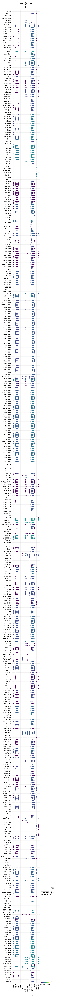

In [58]:
sq.pl.ligrec(adata, 
             cluster_key="cluster",
             source_groups="Hippocampus", 
             #target_groups=["Pyramidal_layer_dentate_gyrus", "Pyramidal_layer"],
             means_range=(3, np.inf),
             alpha=0.005,
             swap_axes=False,)

Analyze Ripley’s L function
====================
- compute the Ripley’s L function.  
The Ripley’s L function is a descriptive statistics generally used to determine whether points have a random, dispersed or clustered distribution pattern at certain scale. The Ripley’s L is a variance-normalized version of the Ripley’s K statistic.


![title](practicum/Unknown.png)

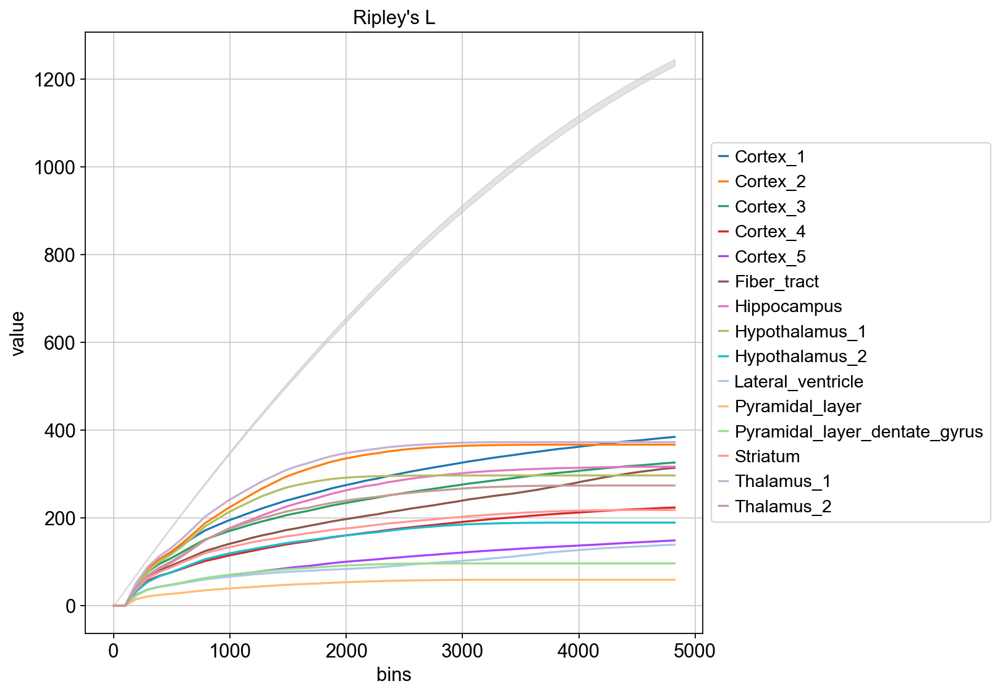

In [74]:
mode = "L"
sq.gr.ripley(adata, cluster_key="cluster", mode=mode)
sq.pl.ripley(adata, cluster_key="cluster", mode=mode)

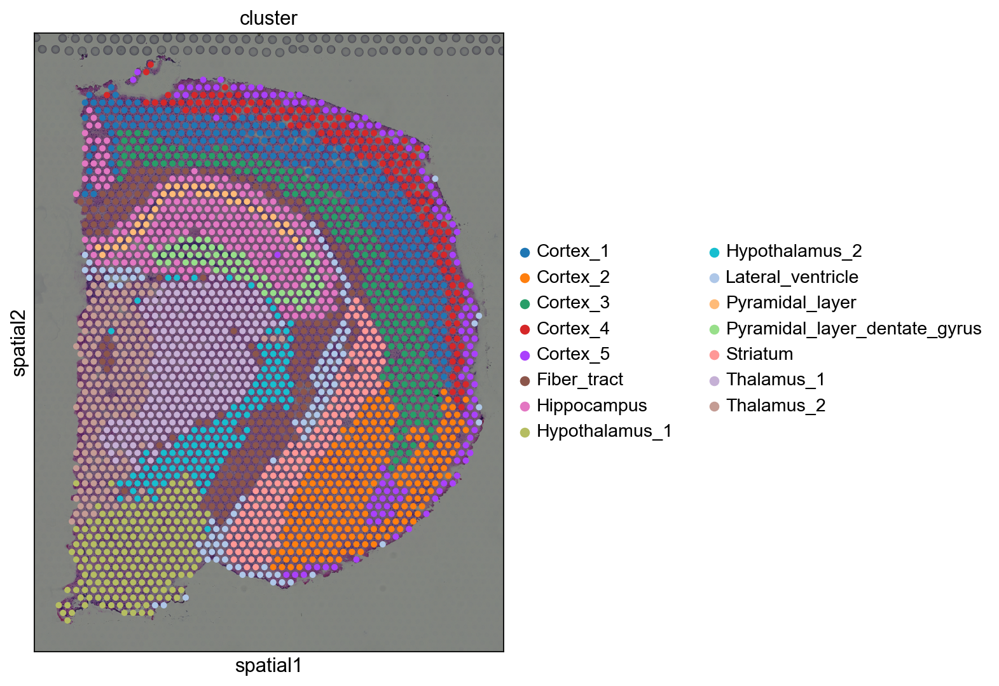

In [63]:
sc.pl.spatial(adata, color="cluster", spot_size=100)

Compute Moran’s I score
---
how to compute the Moran’s I global spatial auto-correlation statistics
The Moran’s I global spatial auto-correlation statistics evaluates whether features (i.e. genes) shows a pattern that is clustered, dispersed or random in the tissue are under consideration.

In [90]:
genes = adata[:, adata.var.highly_variable].var_names.values[:100]

sq.gr.spatial_neighbors(adata)
sq.gr.spatial_autocorr(
    adata,
    mode="moran",
    genes=genes,
    n_perms=100,
    n_jobs=1,
)
adata.uns["moranI"].head(10)

  0%|          | 0/100 [00:00<?, ?/s]

,I,pval_norm,var_norm,pval_z_sim,pval_sim,var_sim,pval_norm_fdr_bh,pval_z_sim_fdr_bh,pval_sim_fdr_bh
3110035E14Rik,0.665132,0.0,0.000131,0.0,0.009901,0.000224,0.0,0.0,0.012074
Resp18,0.649582,0.0,0.000131,0.0,0.009901,0.000268,0.0,0.0,0.012074
1500015O10Rik,0.605940,0.0,0.000131,0.0,0.009901,0.000237,0.0,0.0,0.012074
Ecel1,0.570304,0.0,0.000131,0.0,0.009901,0.000241,0.0,0.0,0.012074
2010300C02Rik,0.539469,0.0,0.000131,0.0,0.009901,0.000212,0.0,0.0,0.012074
Scg2,0.476060,0.0,0.000131,0.0,0.009901,0.000181,0.0,0.0,0.012074
Ogfrl1,0.457945,0.0,0.000131,0.0,0.009901,0.000204,0.0,0.0,0.012074
Itm2c,0.451842,0.0,0.000131,0.0,0.009901,0.000178,0.0,0.0,0.012074
Tuba4a,0.451810,0.0,0.000131,0.0,0.009901,0.000179,0.0,0.0,0.012074
Satb2,0.429162,0.0,0.000131,0.0,0.009901,0.000231,0.0,0.0,0.012074


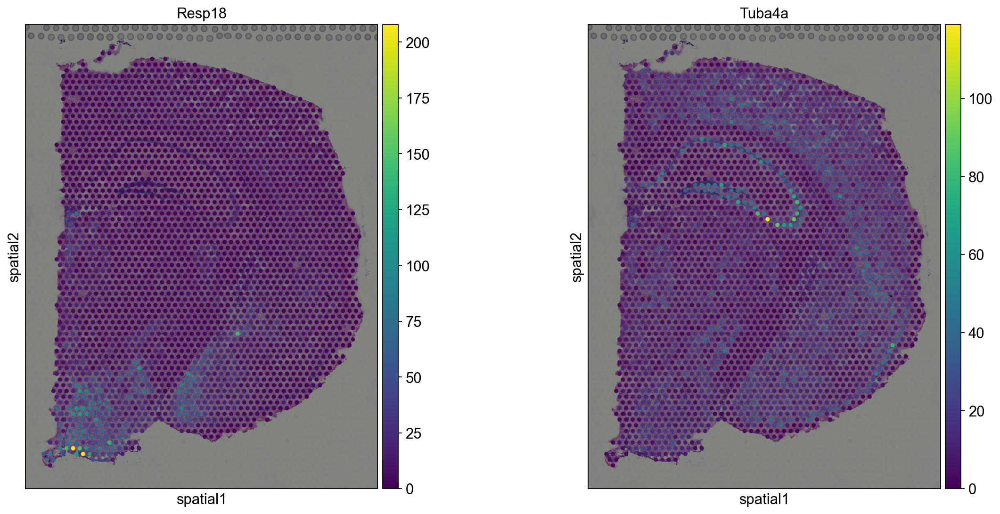

In [75]:
sc.pl.spatial(adata, color=["Resp18", "Tuba4a"])

sepal score
---

In [51]:
sq.gr.spatial_neighbors(adata)

genes = adata.var_names[(adata.var.n_cells > 100) & adata.var.highly_variable][0:100]
sq.gr.sepal(adata, max_neighs=6, genes=genes, n_jobs=1)
adata.uns["sepal_score"].head(10)

  0%|          | 0/100 [00:00<?, ?/s]

,sepal_score
Lct,7.844
1500015O10Rik,6.990
Ecel1,5.283
Fzd5,4.638
Cfap65,4.095
C1ql2,3.183
Slc9a2,2.978
Gm17634,2.868
St18,2.540
Des,2.473


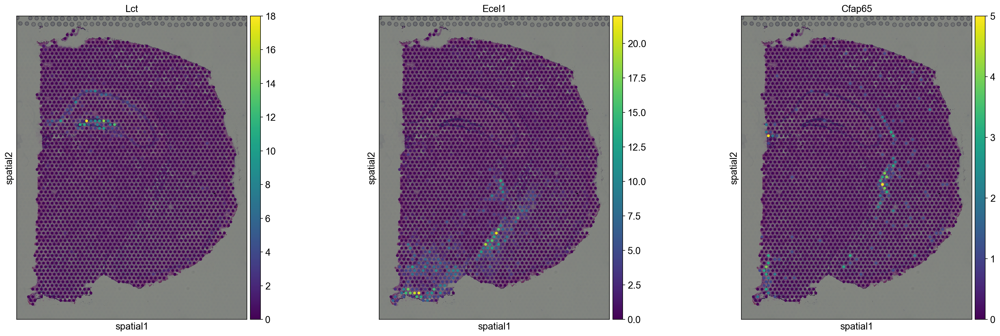

In [76]:
sc.pl.spatial(adata, color=["Lct", "Ecel1", "Cfap65"])

This method identified genes with distinct spatial profiles, involved in key biological processes or characteristic for certain cell types